<ipython-input-32-bc94306a22a6>:11: FutureWarning: The `geometries` module and `geometries_from_X` functions have been renamed the `features` module and `features_from_X` functions. Use these instead. The `geometries` module and function names are deprecated and will be removed in the v2.0.0 release. See the OSMnx v2 migration guide: https://github.com/gboeing/osmnx/issues/1123
  tempe_osm_data = ox.geometries_from_place(place_name, tags)
/usr/local/lib/python3.10/dist-packages/osmnx/features.py:300: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  polygon = gdf_place["geometry"].unary_union


Green spaces from OSM:                        barrier                     geometry  ele  \
element_type osmid                                                 
node         359254733     NaN  POINT (-111.93886 33.44196)  372   
             359260806     NaN  POINT (-111.93403 33.44171)  370   
             359285682     NaN  POINT (-111.97014 33.40116)  354   
             359292677     NaN    POINT (-111.9234 33.4254)  351   
             359292679     NaN  POINT (-111.93892 33.42348)  354   

                       gnis:feature_id leisure  \
element_type osmid                               
node         359254733           14875    park   
             359260806           23936    park   
             359285682           42711    park   
             359292677         2467158    park   
             359292679         2467159    park   

                                                         name   wikidata  \
element_type osmid                                                       

<ipython-input-32-bc94306a22a6>:26: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  plt.legend()


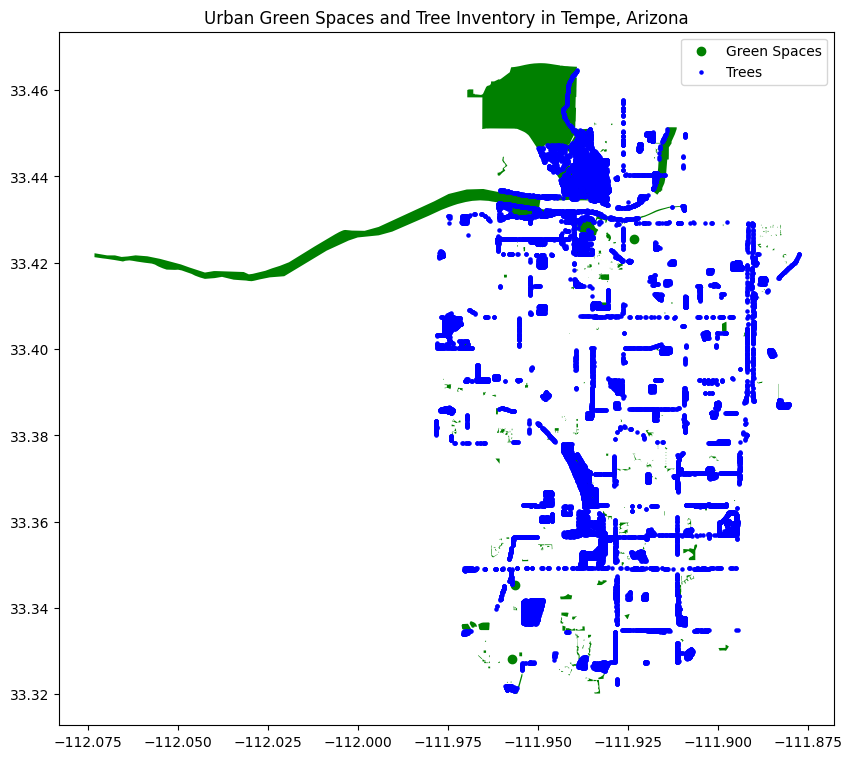

<ipython-input-32-bc94306a22a6>:34: ShapelyDeprecationWarning: The 'type' attribute is deprecated, and will be removed in the future. You can use the 'geom_type' attribute instead.
  if row.geometry.type == 'Polygon':


Tree Inventory CSV Data:               X             Y  OBJECTID  Tree_ID Species_Name  DBH__in_  \
0 -1.246061e+07  3.942223e+06         1        1       Acacia         6   
1 -1.246082e+07  3.942249e+06         2        2       Acacia         6   
2 -1.246060e+07  3.942222e+06         3        3       Acacia         7   
3 -1.246061e+07  3.942223e+06         4        4       Acacia         9   
4 -1.246064e+07  3.942225e+06         5        5       Acacia         9   

   Replacement_Value____  Carbon_Storage__lb_  Carbon_Storage____  \
0                 873.17                 41.3                3.53   
1                 873.17                 41.3                3.53   
2                1050.93                 57.8                4.93   
3                1488.51                100.5                8.57   
4                1488.51                100.5                8.57   

   Gross_Carbon_Sequestration__lb_  ...  Carbon_Avoided__lb_yr_  \
0                              4.6  ...   

In [32]:
# Required libraries
import osmnx as ox
import geopandas as gpd
import matplotlib.pyplot as plt
import folium
import pandas as pd

# Step 1: Load OpenStreetMap data for parks, gardens, playgrounds
place_name = "Tempe, Arizona, USA"
tags = {'leisure': ['park', 'garden', 'playground']}  # Green spaces tags
tempe_osm_data = ox.geometries_from_place(place_name, tags)

# Step 2: Load Tree Inventory data (GeoJSON)
tree_inventory_file = '/content/Tree_Inventory.geojson'
tree_data = gpd.read_file(tree_inventory_file).dropna(subset=['geometry'])  # Remove missing geometries

# Step 3: Display basic info of loaded data
print("Green spaces from OSM:", tempe_osm_data.head())
print("Tree Inventory Data:", tree_data.head())

# Step 4: Static map with matplotlib
fig, ax = plt.subplots(figsize=(10, 10))
tempe_osm_data.plot(ax=ax, color="green", label="Green Spaces")  # Plot green spaces
tree_data.plot(ax=ax, color="blue", marker="o", markersize=5, label="Trees")  # Plot trees
plt.title("Urban Green Spaces and Tree Inventory in Tempe, Arizona")
plt.legend()
plt.show()

# Step 5: Interactive map with folium
tempe_map = folium.Map(location=[33.4255, -111.9400], zoom_start=13)

# Add green spaces to folium map
for idx, row in tempe_osm_data.iterrows():
    if row.geometry.type == 'Polygon':
        folium.GeoJson(row.geometry).add_to(tempe_map)

# Add trees to folium map
for idx, row in tree_data.iterrows():
    folium.Marker(
        location=[row.geometry.y, row.geometry.x],
        popup=row.get('Tree_Type', 'Tree')
    ).add_to(tempe_map)

tempe_map  # Display interactive map

# Step 6: Analyze Tree_Inventory.csv
csv_file = '/content/Tree_Inventory.csv'
tree_csv_data = pd.read_csv(csv_file)

# Display basic info and descriptive statistics
print("Tree Inventory CSV Data:", tree_csv_data.head())
print("Descriptive statistics:", tree_csv_data.describe())


In [33]:
# Required libraries
import osmnx as ox
import geopandas as gpd
import pandas as pd

# Step 1: Load Tree Inventory data (GeoJSON)
tree_inventory_file = '/content/Tree_Inventory.geojson'
tree_data = gpd.read_file(tree_inventory_file)

# Step 2: Load OSM green spaces data (parks, gardens, playgrounds)
place_name = "Tempe, Arizona, USA"
tags = {'leisure': ['park', 'garden', 'playground']}
tempe_osm_data = ox.features_from_place(place_name, tags)

# Clean Tree Inventory data (keep 'Species_Name' and 'geometry')
tree_cleaned = tree_data[['Species_Name', 'geometry']].dropna()

# Tree species summary
tree_summary = tree_cleaned['Species_Name'].value_counts()

# Clean and reproject OSM green spaces data to UTM Zone 12N
green_spaces_cleaned = tempe_osm_data[['geometry']].dropna()
green_spaces_cleaned = green_spaces_cleaned.to_crs(epsg=32612)
green_spaces_cleaned['area_m2'] = green_spaces_cleaned['geometry'].area

# Calculate number of green spaces and total area
num_green_spaces = green_spaces_cleaned.shape[0]
total_green_space_area = green_spaces_cleaned['area_m2'].sum()

# Prepare summary tables
tree_summary_df = pd.DataFrame(tree_summary).reset_index()
tree_summary_df.columns = ['Species_Name', 'Count']

green_space_summary_df = pd.DataFrame({
    'Number of Green Spaces': [num_green_spaces],
    'Total Green Space Area (m²)': [total_green_space_area]
})

# Display summary tables
print("Tree Species Summary:")
print(tree_summary_df)

print("\nGreen Space Summary:")
print(green_space_summary_df)


/usr/local/lib/python3.10/dist-packages/osmnx/features.py:300: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  polygon = gdf_place["geometry"].unary_union


Tree Species Summary:
                      Species_Name  Count
0                Prosopis velutina   1970
1          Parkinsonia microphylla   1877
2               Prosopis chilensis   1722
3             Washingtonia robusta   1255
4                 Dalbergia sissoo   1211
..                             ...    ...
173  Pyrus calleryana 'Aristocrat'      1
174            Eucalyptus nicholii      1
175          Eucalyptus botryoides      1
176                 Quercus prinus      1
177               Ziziphus  jujuba      1

[178 rows x 2 columns]

Green Space Summary:
   Number of Green Spaces  Total Green Space Area (m²)
0                     360                 1.263942e+07


/usr/local/lib/python3.10/dist-packages/osmnx/features.py:300: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  polygon = gdf_place["geometry"].unary_union


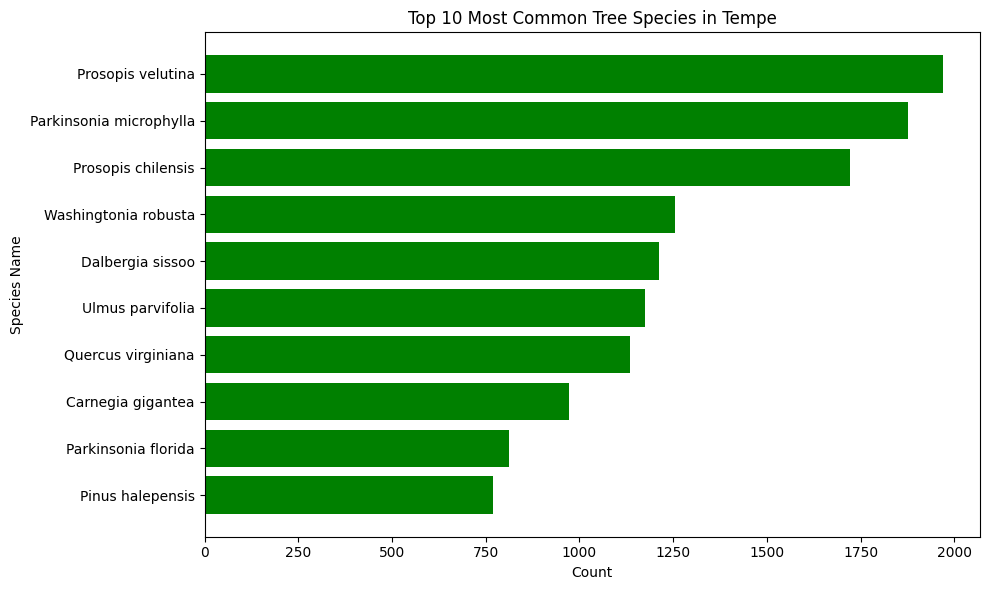

In [36]:
# Required libraries
import osmnx as ox
import geopandas as gpd
import pandas as pd
import matplotlib.pyplot as plt

# Step 1: Load Tree Inventory data (GeoJSON)
tree_inventory_file = '/content/Tree_Inventory.geojson'
tree_data = gpd.read_file(tree_inventory_file)

# Step 2: Load OSM green spaces data (parks, gardens, playgrounds)
place_name = "Tempe, Arizona, USA"
tags = {'leisure': ['park', 'garden', 'playground']}
tempe_osm_data = ox.features_from_place(place_name, tags)

# Clean Tree Inventory data (retain 'Species_Name' and 'geometry')
tree_cleaned = tree_data[['Species_Name', 'geometry']].dropna()

# Tree species summary
tree_summary = tree_cleaned['Species_Name'].value_counts()

# Clean and reproject OSM green spaces data to UTM Zone 12N
green_spaces_cleaned = tempe_osm_data[['geometry']].dropna()
green_spaces_cleaned = green_spaces_cleaned.to_crs(epsg=32612)
green_spaces_cleaned['area_m2'] = green_spaces_cleaned['geometry'].area

# Calculate number of green spaces and total area
num_green_spaces = green_spaces_cleaned.shape[0]
total_green_space_area = green_spaces_cleaned['area_m2'].sum()

# Prepare tree summary table
tree_summary_df = pd.DataFrame(tree_summary).reset_index()
tree_summary_df.columns = ['Species_Name', 'Count']

# Visualization: Bar chart for top 10 most common tree species
top_10_species = tree_summary_df.head(10)

plt.figure(figsize=(10, 6))
plt.barh(top_10_species['Species_Name'], top_10_species['Count'], color='green')
plt.xlabel('Count')
plt.ylabel('Species Name')
plt.title('Top 10 Most Common Tree Species in Tempe')
plt.gca().invert_yaxis()  # Display largest count on top
plt.tight_layout()
plt.show()


/usr/local/lib/python3.10/dist-packages/osmnx/features.py:300: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  polygon = gdf_place["geometry"].unary_union
<ipython-input-37-ffc18dec7001>:32: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


<Figure size 3000x1000 with 0 Axes>

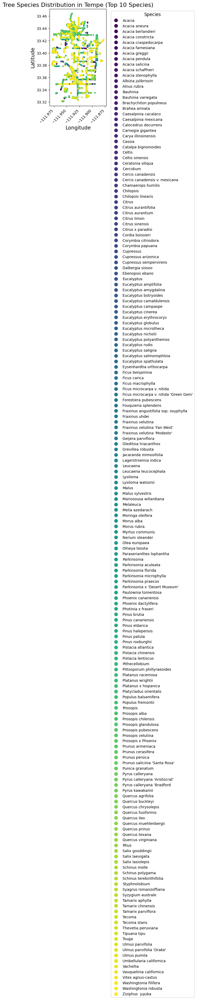

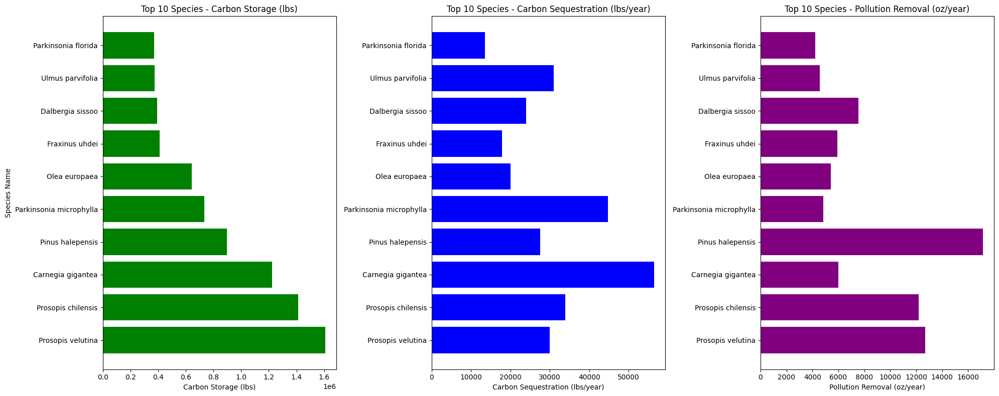

<ipython-input-37-ffc18dec7001>:78: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('Set1', len(top_10_species))


In [37]:
# Required libraries
import osmnx as ox
import geopandas as gpd
import pandas as pd
import matplotlib.pyplot as plt
import folium
import numpy as np

# Step 1: Load Tree Inventory and OSM Green Spaces data
tree_inventory_file = '/content/Tree_Inventory.geojson'
tree_data = gpd.read_file(tree_inventory_file)

place_name = "Tempe, Arizona, USA"
tags = {'leisure': ['park', 'garden', 'playground']}
tempe_osm_data = ox.features_from_place(place_name, tags)

# Clean Tree Inventory and OSM Data
tree_cleaned = tree_data[['Species_Name', 'geometry']].dropna()
green_spaces_cleaned = tempe_osm_data[['geometry']].dropna().to_crs(epsg=32612)
green_spaces_cleaned['area_m2'] = green_spaces_cleaned['geometry'].area

# Visualization: Tree Species Distribution Plot (Wider x-axis)
plt.figure(figsize=(30, 10))
ax = tree_cleaned.plot(column='Species_Name', legend=True, markersize=10, cmap='viridis')
plt.xticks(rotation=45, ha='right')
legend = ax.get_legend()
legend.set_bbox_to_anchor((1.05, 1))
legend.set_title("Species", prop={'size': 12})
plt.title('Tree Species Distribution in Tempe (Top 10 Species)', fontsize=16)
plt.xlabel('Longitude', fontsize=14)
plt.ylabel('Latitude', fontsize=14)
plt.tight_layout()
plt.show()

# Combined Map of Green Spaces and Trees (folium)
combined_map = folium.Map(location=[33.4255, -111.9400], zoom_start=13)
for idx, row in green_spaces_cleaned.iterrows():
    folium.GeoJson(row.geometry, style_function=lambda x: {'color': 'green'}).add_to(combined_map)
for idx, row in tree_cleaned.iterrows():
    folium.CircleMarker(location=[row.geometry.y, row.geometry.x], radius=2, color='green', fill=True, fill_opacity=0.6).add_to(combined_map)
combined_map

# Environmental Benefits Analysis (Carbon Storage, Sequestration, Pollution Removal)
tree_benefits = tree_data.groupby('Species_Name').agg({
    'Carbon_Storage__lb_': 'sum',
    'Gross_Carbon_Sequestration__lb_': 'sum',
    'Pollution_Removal__oz_yr_': 'sum'
}).reset_index()

top_10_benefits = tree_benefits.nlargest(10, 'Carbon_Storage__lb_')

# Subplots for Tree Benefits
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(20, 8))

# Carbon Storage
axes[0].barh(top_10_benefits['Species_Name'], top_10_benefits['Carbon_Storage__lb_'], color='green')
axes[0].set_title('Top 10 Species - Carbon Storage (lbs)')
axes[0].set_xlabel('Carbon Storage (lbs)')
axes[0].set_ylabel('Species Name')

# Carbon Sequestration
axes[1].barh(top_10_benefits['Species_Name'], top_10_benefits['Gross_Carbon_Sequestration__lb_'], color='blue')
axes[1].set_title('Top 10 Species - Carbon Sequestration (lbs/year)')
axes[1].set_xlabel('Carbon Sequestration (lbs/year)')

# Pollution Removal
axes[2].barh(top_10_benefits['Species_Name'], top_10_benefits['Pollution_Removal__oz_yr_'], color='purple')
axes[2].set_title('Top 10 Species - Pollution Removal (oz/year)')
axes[2].set_xlabel('Pollution Removal (oz/year)')

plt.tight_layout()
plt.show()

# Color-Coded Species Map (folium)
top_10_species = tree_data['Species_Name'].value_counts().head(10).index.tolist()
top_10_tree_data = tree_data[tree_data['Species_Name'].isin(top_10_species)]

colors = plt.cm.get_cmap('Set1', len(top_10_species))
species_color_map = {species: colors(i) for i, species in enumerate(top_10_species)}

def rgb_to_hex(rgb):
    return '#%02x%02x%02x' % (int(rgb[0]*255), int(rgb[1]*255), int(rgb[2]*255))

top_10_species_map = folium.Map(location=[33.4255, -111.9400], zoom_start=13)

# Add trees with color-coded markers
for idx, row in top_10_tree_data.iterrows():
    if row.geometry is not None:
        color = rgb_to_hex(species_color_map[row['Species_Name']])
        folium.CircleMarker(
            location=[row.geometry.y, row.geometry.x],
            radius=5,
            color=color,
            fill=True,
            fill_opacity=0.7,
            popup=f"Species: {row['Species_Name']}"
        ).add_to(top_10_species_map)

# Add custom legend to the map
legend_html = '''
<div style="position: fixed;
     bottom: 50px; left: 50px; width: 250px; height: 200px;
     background-color: white; border:2px solid grey; z-index:9999; font-size:14px;">
     <b>&nbsp; Tree Species Legend</b><br>
     &nbsp; Prosopis velutina: <i style="background:{}">&nbsp;&nbsp;&nbsp;&nbsp;</i><br>
     &nbsp; Parkinsonia microphylla: <i style="background:{}">&nbsp;&nbsp;&nbsp;&nbsp;</i><br>
     &nbsp; Prosopis chilensis: <i style="background:{}">&nbsp;&nbsp;&nbsp;&nbsp;</i><br>
     &nbsp; Washingtonia robusta: <i style="background:{}">&nbsp;&nbsp;&nbsp;&nbsp;</i><br>
     &nbsp; Dalbergia sissoo: <i style="background:{}">&nbsp;&nbsp;&nbsp;&nbsp;</i><br>
     &nbsp; Other species...<br>
</div>
'''.format(rgb_to_hex(species_color_map['Prosopis velutina']),
           rgb_to_hex(species_color_map['Parkinsonia microphylla']),
           rgb_to_hex(species_color_map['Prosopis chilensis']),
           rgb_to_hex(species_color_map['Washingtonia robusta']),
           rgb_to_hex(species_color_map['Dalbergia sissoo']))

top_10_species_map.get_root().html.add_child(folium.Element(legend_html))
top_10_species_map
